In [1]:
#!pip install pydeck -q

     |████████████████████████████████| 4.3 MB 4.5 MB/s 
     |████████████████████████████████| 131 kB 47.1 MB/s 
     |████████████████████████████████| 130 kB 62.6 MB/s 
     |████████████████████████████████| 793 kB 56.2 MB/s 
     |████████████████████████████████| 428 kB 39.5 MB/s 
     |████████████████████████████████| 381 kB 44.1 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
jupyter-console 5.2.0 requires prompt-toolkit<2.0.0,>=1.0.0, but you have prompt-toolkit 3.0.29 which is incompatible.
google-colab 1.0.0 requires ipykernel~=4.10, but you have ipykernel 6.13.0 which is incompatible.
google-colab 1.0.0 requires ipython~=5.5.0, but you have ipython 7.32.0 which is incompatible.
google-colab 1.0.0 requires tornado~=5.1.0; python_version >= "3.0", but you have tornado 6.1 which is incompatible.


In [47]:
import pydeck as pdk
import numpy as np

import pandas as pd 
import seaborn as sns #seaborn til plots
from matplotlib import pyplot as plt #plot control
sns.set() #plot style

#sns.set(style="ticks", context="talk")
#plt.style.use("dark_background")

from jupyterthemes import jtplot
jtplot.style(theme='monokai', context='notebook', ticks=True, grid=False)

In [2]:
data = pd.read_csv('http://data.insideairbnb.com/denmark/hovedstaden/copenhagen/2021-12-28/visualisations/listings.csv')

In [3]:
data

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,6983,Copenhagen 'N Livin',16774,Simon,NaN,Nrrebro,55.686410,12.547410,Private room,380,2,168,2019-07-19,1.12,1,0,0,NaN
1,26057,Lovely house - most attractive area,109777,Kari,NaN,Indre By,55.691960,12.576370,Entire home/apt,2400,4,55,2021-12-06,0.56,1,359,5,NaN
2,31094,"Very central and cozy, new kitchen",129976,Ebbe,NaN,Vesterbro-Kongens Enghave,55.665390,12.556390,Entire home/apt,750,2,17,2017-08-25,0.12,1,0,0,NaN
3,32379,120 m2 artist flat on Vesterbro,140105,Lise,NaN,Vesterbro-Kongens Enghave,55.672970,12.553270,Entire home/apt,1153,3,76,2021-10-18,0.55,2,92,3,NaN
4,32841,Cozy flat for Adults/Quiet for kids,142143,Anders & Maria,NaN,sterbro,55.711760,12.570910,Entire home/apt,617,100,7,2016-09-15,0.05,1,204,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9721,53987106,Bright harbor front apartment with workspace,44141258,Matthew And Louise,NaN,Vesterbro-Kongens Enghave,55.656162,12.561522,Entire home/apt,900,2,0,NaN,NaN,1,7,0,NaN
9722,53995075,"By the metro and the beach - Amager (21D,1)",375703436,Søren,NaN,Amager st,55.666155,12.624458,Entire home/apt,700,10,0,NaN,NaN,9,365,0,NaN
9723,53996808,Beatiful and cozy room in Copenhague,30103113,Manuel,NaN,Amager Vest,55.635714,12.576664,Private room,240,5,0,NaN,NaN,1,349,0,NaN
9724,53996887,Dejlig københavnerlejlighed i hjertet af Køben...,324550278,Helena,NaN,Nrrebro,55.691309,12.557312,Entire home/apt,720,2,0,NaN,NaN,1,5,0,NaN


In [4]:
data = data[data.number_of_reviews > 0]

In [5]:
data.room_type.value_counts()

Entire home/apt    7258
Private room       1150
Hotel room           20
Shared room          12
Name: room_type, dtype: int64

In [6]:
data.room_type.unique()

array(['Private room', 'Entire home/apt', 'Shared room', 'Hotel room'],
      dtype=object)

In [7]:
data = data[data.room_type.isin(['Private room', 'Entire home/apt'])]

In [43]:
data.neighbourhood.value_counts()

Indre By                     1428
Vesterbro-Kongens Enghave    1421
Nrrebro                      1370
sterbro                       874
Frederiksberg                 862
Amager Vest                   775
Amager st                     620
Valby                         330
Bispebjerg                    325
Vanlse                        219
Brnshj-Husum                  154
Name: neighbourhood, dtype: int64

<AxesSubplot:xlabel='count', ylabel='neighbourhood'>

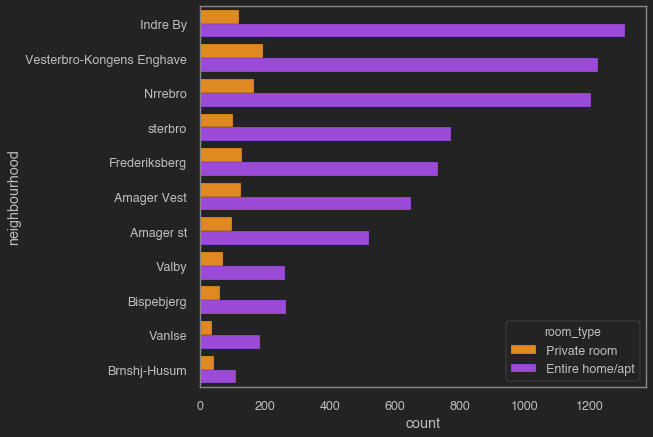

In [48]:
sns.countplot(y="neighbourhood", 
                hue="room_type", 
                data=data, 
                palette=palette,
                order = data.neighbourhood.value_counts().index)

In [9]:
palette=['#FF8C00','#A034F0', '#159090']

<AxesSubplot:xlabel='price', ylabel='neighbourhood'>

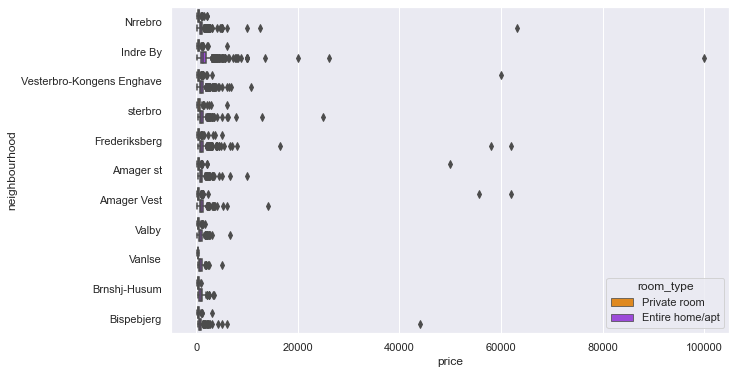

In [10]:
plt.figure(figsize=(10,6))

sns.boxplot(data = data, x = "price", y = "neighbourhood" , 
            hue = "room_type", palette=palette)

In [11]:
data['price_z'] = (data['price'] -data['price'].mean())/data['price'].std(ddof=0)

In [12]:
data['price_z'] = data['price_z'].abs()

In [13]:
data = data[data.price_z < 3]

<AxesSubplot:xlabel='price', ylabel='neighbourhood'>

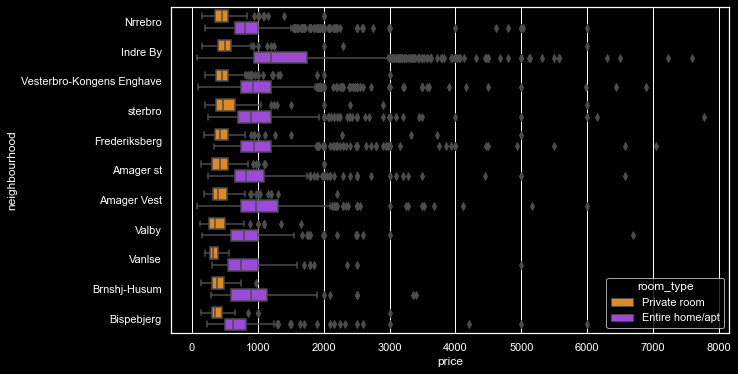

In [35]:
plt.figure(figsize=(10,6))

sns.boxplot(data = data, x = "price", y = "neighbourhood" , 
            hue = "room_type", palette=palette)

<AxesSubplot:xlabel='price', ylabel='neighbourhood'>

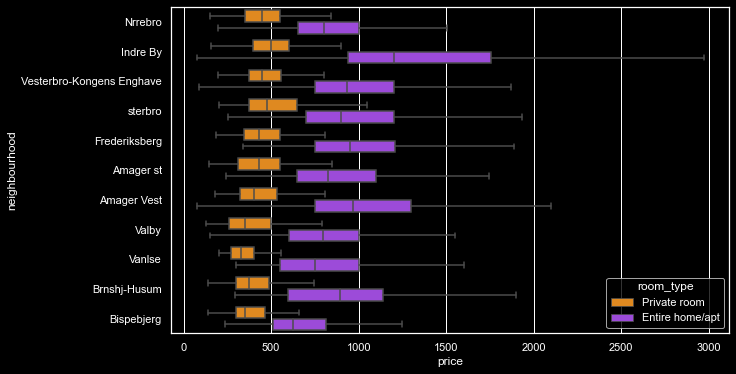

In [34]:
plt.figure(figsize=(10,6))

sns.boxplot(data = data, x = "price", y = "neighbourhood" , 
            hue = "room_type", palette=palette, showfliers=False)

In [16]:
data['log_price'] = np.log(data['price'])

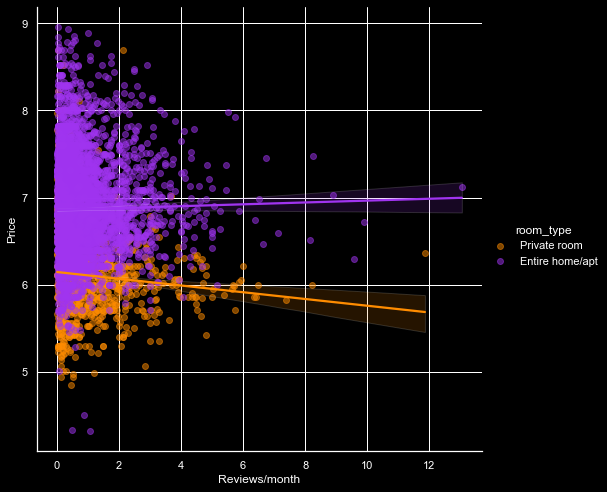

In [33]:
g = sns.lmplot(x="reviews_per_month",
               y="log_price",
               hue="room_type",
               height=7,
               data=data,
                scatter_kws={'alpha':0.5},
               palette=palette)
g.set_xlabels('Reviews/month')
g.set_ylabels('Price')

In [24]:
# Define a layer to display on a map
layer = pdk.Layer(
    "ScatterplotLayer",
    data,
    pickable=True,
    opacity=0.2,
    stroked=True,
    filled=True,
    radius_scale=6,
    radius_min_pixels=1,
    radius_max_pixels=100,
    line_width_min_pixels=1,
    get_position=["longitude", "latitude"],
    get_radius="log_price",
    get_fill_color=[255, 140, 0],
    get_line_color=[0, 0, 0],
)

In [25]:
# Set the viewport location
view_state = pdk.ViewState(latitude=data['latitude'].mean(), longitude=data['longitude'].mean(), zoom=11, bearing=0, pitch=0)

# Render
r = pdk.Deck(layers=[layer], initial_view_state=view_state, tooltip={"text": "{name}\n{room_type}\n{price}"})

In [55]:
    df = pd.DataFrame(
    np.random.randn(1000, 2) / [50, 50] + [37.76, -122.4],
    columns=['lat', 'lon'])


In [26]:
r

{"initialViewState": {"bearing": 0, "latitude": 55.67982426762625, "longitude": 12.559667035324122, "pitch": 0, "zoom": 11}, "layers": [{"@@type": "ScatterplotLayer", "data": [{"availability_365": 0, "calculated_host_listings_count": 1, "host_id": 16774, "host_name": "Simon", "id": 6983, "last_review": "2019-07-19", "latitude": 55.68641, "license": NaN, "log_price": 5.940171252720432, "longitude": 12.54741, "minimum_nights": 2, "name": "Copenhagen 'N Livin'", "neighbourhood": "Nrrebro", "neighbourhood_group": NaN, "number_of_reviews": 168, "number_of_reviews_ltm": 0, "price": 380, "price_z": 0.32168073661441127, "reviews_per_month": 1.12, "room_type": "Private room"}, {"availability_365": 359, "calculated_host_listings_count": 1, "host_id": 109777, "host_name": "Kari", "id": 26057, "last_review": "2021-12-06", "latitude": 55.69196, "license": NaN, "log_price": 7.783224016336037, "longitude": 12.57637, "minimum_nights": 4, "name": "Lovely house - most attractive area", "neighbourhood": "Indre By", "neighbourhood_group": NaN, "number_of_reviews": 55, "number_of_reviews_ltm": 5, "price": 2400, "price_z": 0.5820120385729807, "reviews_per_month": 0.56, "room_type": "Entire home/apt"}, {"availability_365": 0, "calculated_host_listings_count": 1, "host_id": 129976, "host_name": "Ebbe", "id": 31094, "last_review": "2017-08-25", "latitude": 55.66539, "license": NaN, "log_price": 6.620073206530356, "longitude": 12.55639, "minimum_nights": 2, "name": "Very central and cozy, new kitchen", "neighbourhood": "Vesterbro-Kongens Enghave", "neighbourhood_group": NaN, "number_of_reviews": 17, "number_of_reviews_ltm": 0, "price": 750, "price_z": 0.15615285205038404, "reviews_per_month": 0.12, "room_type": "Entire home/apt"}, {"availability_365": 92, "calculated_host_listings_count": 2, "host_id": 140105, "host_name": "Lise", "id": 32379, "last_review": "2021-10-18", "latitude": 55.67297, "license": NaN, "log_price": 7.050122520269059, "longitude": 12.55327, "minimum_nights": 3, "name": "120 m2  artist flat on Vesterbro", "neighbourhood": "Vesterbro-Kongens Enghave", "neighbourhood_group": NaN, "number_of_reviews": 76, "number_of_reviews_ltm": 3, "price": 1153, "price_z": 0.024138330326110503, "reviews_per_month": 0.55, "room_type": "Entire home/apt"}, {"availability_365": 204, "calculated_host_listings_count": 1, "host_id": 142143, "host_name": "Anders & Maria", "id": 32841, "last_review": "2016-09-15", "latitude": 55.71176, "license": NaN, "log_price": 6.424869023905388, "longitude": 12.57091, "minimum_nights": 100, "name": "Cozy flat for Adults/Quiet for kids", "neighbourhood": "sterbro", "neighbourhood_group": NaN, "number_of_reviews": 7, "number_of_reviews_ltm": 0, "price": 617, "price_z": 0.21565341596123708, "reviews_per_month": 0.05, "room_type": "Entire home/apt"}, {"availability_365": 285, "calculated_host_listings_count": 1, "host_id": 145671, "host_name": "Mette", "id": 33680, "last_review": "2019-03-14", "latitude": 55.66631, "license": NaN, "log_price": 6.907755278982137, "longitude": 12.54555, "minimum_nights": 6, "name": "Best location on Vesterbro/Cph", "neighbourhood": "Vesterbro-Kongens Enghave", "neighbourhood_group": NaN, "number_of_reviews": 71, "number_of_reviews_ltm": 0, "price": 1000, "price_z": 0.044309686804419685, "reviews_per_month": 0.51, "room_type": "Entire home/apt"}, {"availability_365": 0, "calculated_host_listings_count": 1, "host_id": 160390, "host_name": "Jeanette", "id": 37159, "last_review": "2017-08-22", "latitude": 55.68547, "license": NaN, "log_price": 7.822444729489319, "longitude": 12.56543, "minimum_nights": 5, "name": "Unique space on greatest location", "neighbourhood": "Indre By", "neighbourhood_group": NaN, "number_of_reviews": 11, "number_of_reviews_ltm": 0, "price": 2496, "price_z": 0.624959814027431, "reviews_per_month": 0.08, "room_type": "Entire home/apt"}, {"availability_365": 84, "calculated_host_listings_count": 1, "host_id": 261977, "host_name": "Morten", "id": 55465, "last_review": "2021-

In [28]:
# custom pretty color palette
colorRange = [
  [1, 152, 189],
  [73, 227, 206],
  [216, 254, 181],
  [254, 237, 177],
  [254, 173, 84],
  [209, 55, 78]
]

# Define a layer to display on a map

layer = pdk.Layer(
    "HexagonLayer",
    data,
    get_position=["longitude", "latitude"],
    auto_highlight=True,
    elevation_scale=50,
    pickable=True,
    radius=50,
    opacity=0.3,
    elevation_range=[0, 200],
    color_range = colorRange,
    extruded=True,
    coverage=1,
)

# Set the viewport location
view_state = pdk.ViewState(latitude=data['latitude'].mean(), longitude=data['longitude'].mean(), zoom=10, min_zoom=5, max_zoom=15, pitch=40.5, bearing=-27.36)

# Render
r = pdk.Deck(layers=[layer], initial_view_state=view_state, tooltip={"text": "{elevationValue}"})

In [29]:
r

{"initialViewState": {"bearing": -27.36, "latitude": 55.67982426762625, "longitude": 12.559667035324122, "maxZoom": 15, "minZoom": 5, "pitch": 40.5, "zoom": 10}, "layers": [{"@@type": "HexagonLayer", "autoHighlight": true, "colorRange": [[1, 152, 189], [73, 227, 206], [216, 254, 181], [254, 237, 177], [254, 173, 84], [209, 55, 78]], "coverage": 1, "data": [{"availability_365": 0, "calculated_host_listings_count": 1, "host_id": 16774, "host_name": "Simon", "id": 6983, "last_review": "2019-07-19", "latitude": 55.68641, "license": NaN, "log_price": 5.940171252720432, "longitude": 12.54741, "minimum_nights": 2, "name": "Copenhagen 'N Livin'", "neighbourhood": "Nrrebro", "neighbourhood_group": NaN, "number_of_reviews": 168, "number_of_reviews_ltm": 0, "price": 380, "price_z": 0.32168073661441127, "reviews_per_month": 1.12, "room_type": "Private room"}, {"availability_365": 359, "calculated_host_listings_count": 1, "host_id": 109777, "host_name": "Kari", "id": 26057, "last_review": "2021-12-06", "latitude": 55.69196, "license": NaN, "log_price": 7.783224016336037, "longitude": 12.57637, "minimum_nights": 4, "name": "Lovely house - most attractive area", "neighbourhood": "Indre By", "neighbourhood_group": NaN, "number_of_reviews": 55, "number_of_reviews_ltm": 5, "price": 2400, "price_z": 0.5820120385729807, "reviews_per_month": 0.56, "room_type": "Entire home/apt"}, {"availability_365": 0, "calculated_host_listings_count": 1, "host_id": 129976, "host_name": "Ebbe", "id": 31094, "last_review": "2017-08-25", "latitude": 55.66539, "license": NaN, "log_price": 6.620073206530356, "longitude": 12.55639, "minimum_nights": 2, "name": "Very central and cozy, new kitchen", "neighbourhood": "Vesterbro-Kongens Enghave", "neighbourhood_group": NaN, "number_of_reviews": 17, "number_of_reviews_ltm": 0, "price": 750, "price_z": 0.15615285205038404, "reviews_per_month": 0.12, "room_type": "Entire home/apt"}, {"availability_365": 92, "calculated_host_listings_count": 2, "host_id": 140105, "host_name": "Lise", "id": 32379, "last_review": "2021-10-18", "latitude": 55.67297, "license": NaN, "log_price": 7.050122520269059, "longitude": 12.55327, "minimum_nights": 3, "name": "120 m2  artist flat on Vesterbro", "neighbourhood": "Vesterbro-Kongens Enghave", "neighbourhood_group": NaN, "number_of_reviews": 76, "number_of_reviews_ltm": 3, "price": 1153, "price_z": 0.024138330326110503, "reviews_per_month": 0.55, "room_type": "Entire home/apt"}, {"availability_365": 204, "calculated_host_listings_count": 1, "host_id": 142143, "host_name": "Anders & Maria", "id": 32841, "last_review": "2016-09-15", "latitude": 55.71176, "license": NaN, "log_price": 6.424869023905388, "longitude": 12.57091, "minimum_nights": 100, "name": "Cozy flat for Adults/Quiet for kids", "neighbourhood": "sterbro", "neighbourhood_group": NaN, "number_of_reviews": 7, "number_of_reviews_ltm": 0, "price": 617, "price_z": 0.21565341596123708, "reviews_per_month": 0.05, "room_type": "Entire home/apt"}, {"availability_365": 285, "calculated_host_listings_count": 1, "host_id": 145671, "host_name": "Mette", "id": 33680, "last_review": "2019-03-14", "latitude": 55.66631, "license": NaN, "log_price": 6.907755278982137, "longitude": 12.54555, "minimum_nights": 6, "name": "Best location on Vesterbro/Cph", "neighbourhood": "Vesterbro-Kongens Enghave", "neighbourhood_group": NaN, "number_of_reviews": 71, "number_of_reviews_ltm": 0, "price": 1000, "price_z": 0.044309686804419685, "reviews_per_month": 0.51, "room_type": "Entire home/apt"}, {"availability_365": 0, "calculated_host_listings_count": 1, "host_id": 160390, "host_name": "Jeanette", "id": 37159, "last_review": "2017-08-22", "latitude": 55.68547, "license": NaN, "log_price": 7.822444729489319, "longitude": 12.56543, "minimum_nights": 5, "name": "Unique space on greatest location", "neighbourhood": "Indre By", "neighbourhood_group": NaN, "number_of_reviews": 11, "number_of_reviews_ltm": 0, "price": 2496, "price_z": 0.624959814027431, "reviews_per_mo

In [61]:
import statsmodels.api as sm

In [62]:
from stargazer.stargazer import Stargazer

In [63]:
est = sm.OLS(endog=data['reviews_per_month'], exog=sm.add_constant(data['price'])).fit()
est2 = sm.OLS(endog=data['reviews_per_month'], exog=sm.add_constant(data[['price','availability_365']])).fit()


stargazer = Stargazer([est, est2])

In [71]:
stargazer